# Analysing HJD correction differences

We assume the astropy version is correct, how different is the pipeline implementation?

We take 1000 random samples from the NGTS database and record the following information:

* `tel_ra`
* `tel_dec`
* `sun_ra`
* `sun_dec`
* `mjd`

The `astropy` code requires ra/dec coordinates, the location of the observer (`paranal` is a valid entry) and the `mjd` of the observation.

The pipeline code requires ra/dec coordinates along with the coordinates of the Sun (computed by Paladin). The difference between the two codes is computed and analysed below. First some imports:

In [1]:
%matplotlib inline
import pandas as pd
from bokeh import charts
import matplotlib.pyplot as plt
from bokeh import plotting as bplt
import itertools as itr

plt.style.use(['bmh', 'seaborn-talk'])
charts.output_notebook()

Loading BokehJS ...

Read in the results from disk as a csv file. It records the HJD correction in seconds for each code version (`pipeline` and `astropy`) along with the columns listed above.

In [2]:
df = pd.read_csv('results.csv')
df.head()

,pipeline,astropy,ra,dec,sun_ra,sun_dec,mjd
0,265.885573,263.032525,80.697157,-25.328111,218.1810,-14.99770,57329.356470
1,266.013876,267.117085,148.401743,-45.655925,20.2570,8.53633,57124.144479
2,248.355238,250.014205,148.396943,-45.656549,26.6195,10.99260,57131.020683
3,308.193681,312.202251,300.076900,-44.945114,161.8520,7.68940,57268.151991
4,416.068785,422.117261,299.940021,-45.013529,88.3604,23.42600,57193.118727


Add a column representing the difference in times in seconds, and visualise.

In [3]:
df['dt'] = df['pipeline'] - df['astropy']

In [4]:
def dt_histogram(df):
    p = charts.Histogram(df, 'dt', title='Difference in seconds', xlabel='dt [s]')
    charts.show(p)

In [5]:
dt_histogram(df)

It's encouraging that the values are < 10 seconds in each direction. At least we're not _miles_ away from the truth. Does this difference correlate with anything?

In [6]:
def plottable_keys(df):
    return sorted(list(set(df.keys()) - set(['astropy', 'pipeline', 'dt'])))

In [7]:
def add_noise(data, noise_mag=0.1):
    diffs = np.unique(np.diff(data))
    av_diff = np.abs(diffs.mean())
    noise = np.random.normal(0., noise_mag * av_diff, size=data.size)
    return data + noise

In [8]:
def simple_scatter_exploration(df, add_xnoise=False):
    keys = plottable_keys(df)
    plots = []
    for key in keys:
        if add_xnoise:
            newx = add_noise(df[key].values)
        else:
            newx = df[key].values

        newdf = pd.DataFrame({
                key: newx,
                'dt': df['dt'].values,
                })
        
        fig = charts.Scatter(newdf, x=key, y='dt', ylabel='dt [s]', title=key)
        plots.append(fig)
    p = bplt.vplot(*plots)
    bplt.show(p)

In [9]:
simple_scatter_exploration(df)

The strongest correlation seems to be with `ra`, but there are definitely systematic errors here. It's likely that the error is a function of these parameters, rather than directly of a single parameter. Bokeh grinds my browser to a halt so switching over to `matplotlib`.

In [12]:
def compare_3d(df, add_xnoise=False):
    keys = plottable_keys(df)
    for x_key, colour_key in itr.product(keys, keys):
        if x_key == colour_key:
            continue
            
        if add_xnoise:
            newx = add_noise(df[x_key].values)
        else:
            newx = df[x_key].values

        fig, axis = plt.subplots()
        mappable = axis.scatter(newx, df['dt'], c=df[colour_key], s=50, cmap='viridis', edgecolor='None')
        axis.set(xlabel=x_key, ylabel='dt [s]')
        cbar = fig.colorbar(mappable, ax=axis)
        cbar.set_label(colour_key)

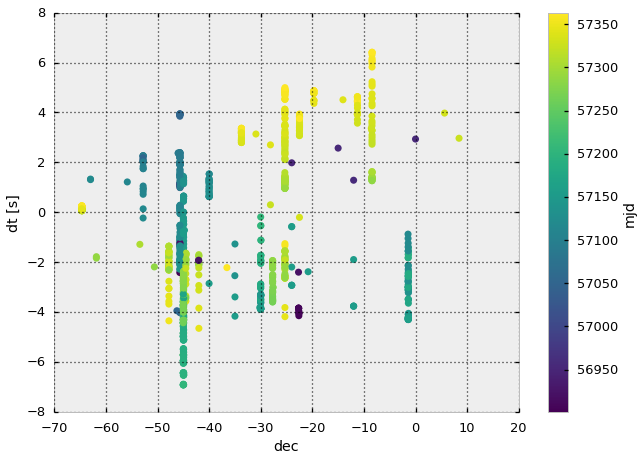

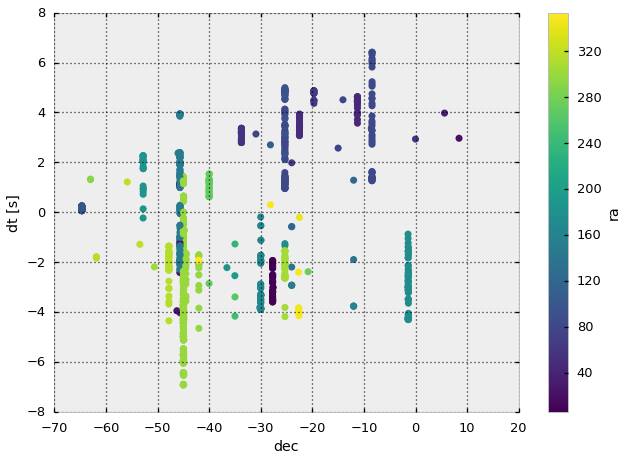

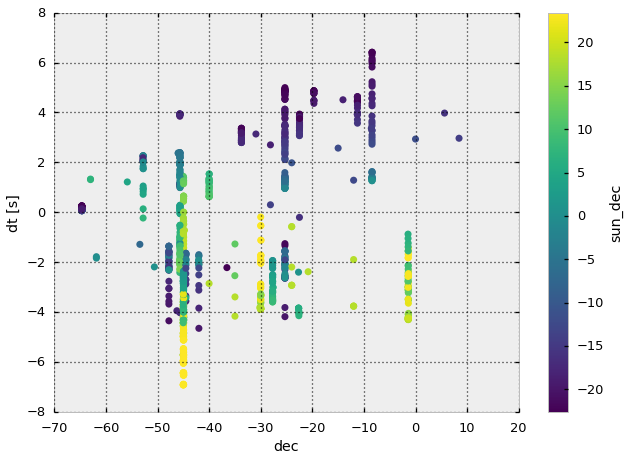

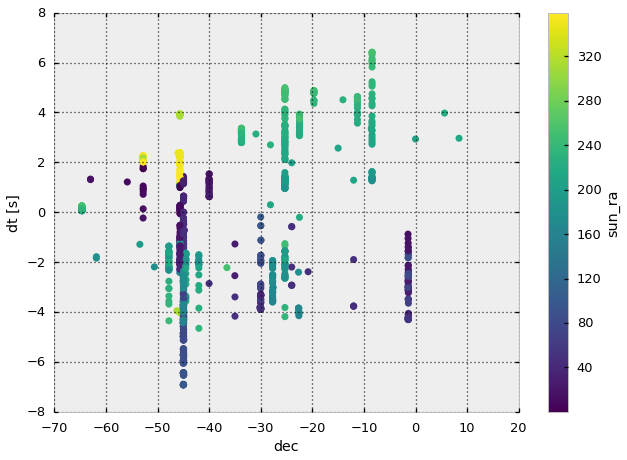

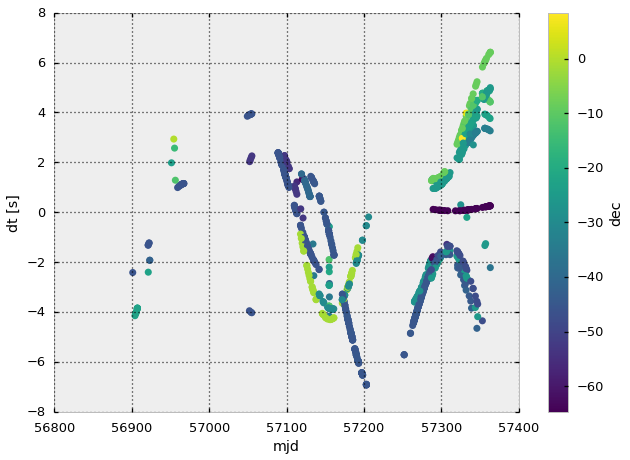

...

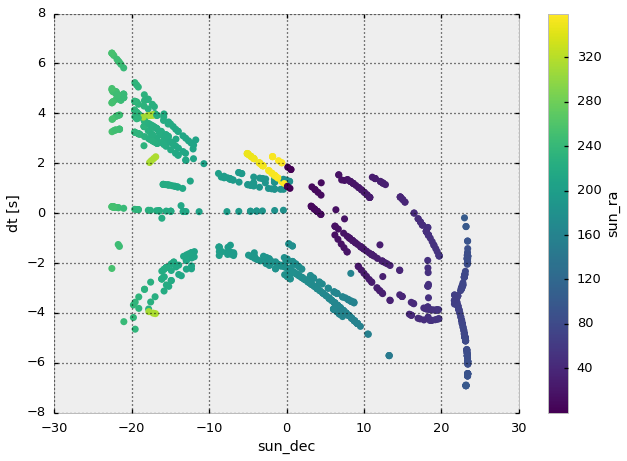

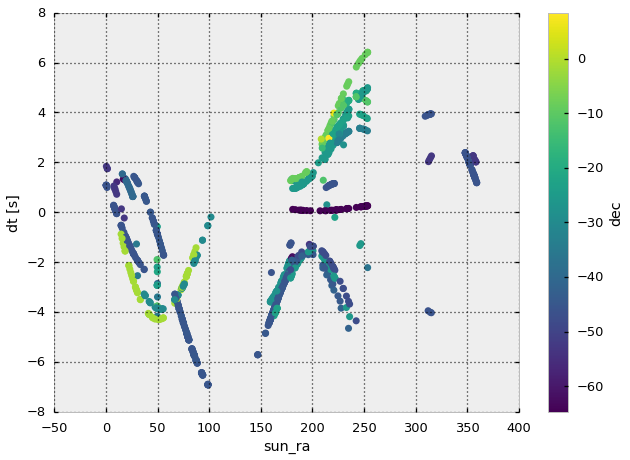

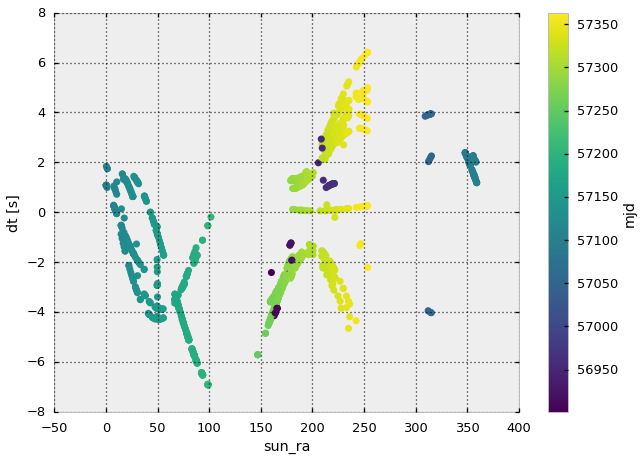

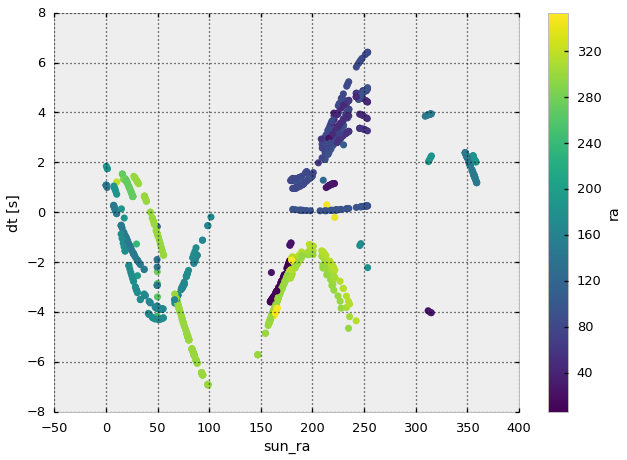

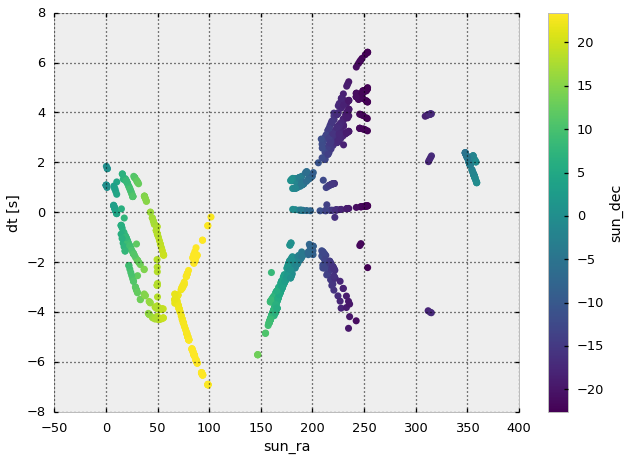

In [13]:
compare_3d(df)

## Trying something more systematic

Why don't we sample from a uniform grid?!

In [14]:
import numpy as np
import itertools
from astropy import units as u
from concurrent.futures import ProcessPoolExecutor

npoints_per_axis = 10
ra_ = np.linspace(0., 360., npoints_per_axis)
dec_ = np.linspace(-90., 20., npoints_per_axis)
sun_ra_ = np.linspace(0., 360., npoints_per_axis)
sun_dec_ = np.linspace(-23.45, 23.45, npoints_per_axis)
mjd_ = np.linspace(56658, 57388, npoints_per_axis)
combinations = itertools.product(ra_, dec_, sun_ra_, sun_dec_, mjd_)
combinations_dicts = (
    {
        'tel_ra': ra,
        'tel_dec': dec,
        'sun_ra': sun_ra,
        'sun_dec': sun_dec,
        'mjd': mjd
        } for (ra, dec, sun_ra, sun_dec, mjd) in combinations
    )

Define a helper function to compute the difference, and we can build a `pandas.DataFrame` of the same structure as `df`.

In [15]:
import sys
sys.path.insert(0, '..')
from test_hjdcorr_accuracy import (astropy_hjd_correction, compute_hjd_correction as pipeline_hjd_correction,
                                   build_pipeline_kwargs, build_astropy_kwargs)

def run_(fixture):
    astropy_kwargs = build_astropy_kwargs(fixture)
    pipeline_kwargs = build_pipeline_kwargs(fixture)
    
    pipeline_dt = float(pipeline_hjd_correction(**pipeline_kwargs))
    astropy_dt = float(astropy_hjd_correction(**astropy_kwargs).to(u.second).value)
    
    out = {'dt': pipeline_dt - astropy_dt}
    out.update(**fixture)
    return out

This is quite a large grid search, so this takes a while. Parallelise it to be quicker.

In [16]:
%time 
with ProcessPoolExecutor() as executor:
    results = pd.DataFrame(executor.map(run_, combinations_dicts))

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 3.81 µs


In [17]:
results = results.rename(columns={'tel_ra': 'ra', 'tel_dec': 'dec'})
results.head()

,dt,mjd,sun_dec,sun_ra,dec,ra
0,-6.549950,56658.000000,-23.45,0.0,-90.0,0.0
1,-206.152304,56739.111111,-23.45,0.0,-90.0,0.0
2,-397.633606,56820.222222,-23.45,0.0,-90.0,0.0
3,-271.608430,56901.333333,-23.45,0.0,-90.0,0.0
4,-30.812456,56982.444444,-23.45,0.0,-90.0,0.0


In [18]:
p = charts.Histogram(results, 'dt', title='Difference in seconds', xlabel='dt [s]')
charts.show(p)

This is a little more worrying. Now the data show up to quite a large correction, going beyond the 8 minute limits (~500 seconds).

In [19]:
simple_scatter_exploration(results, add_xnoise=True)

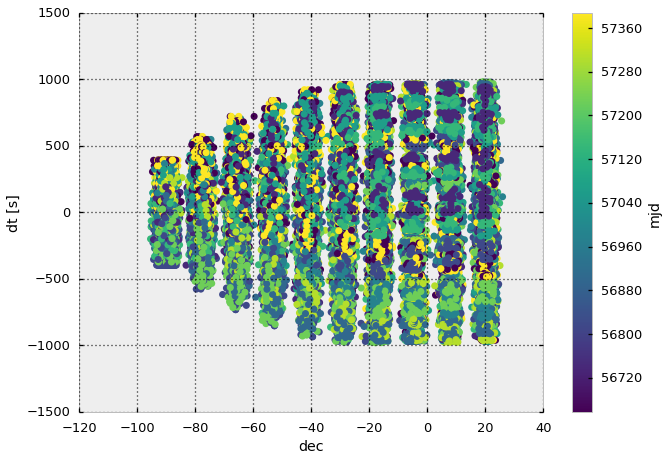

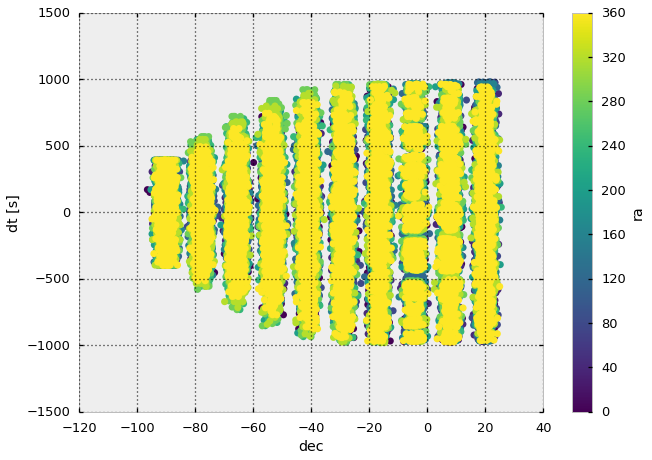

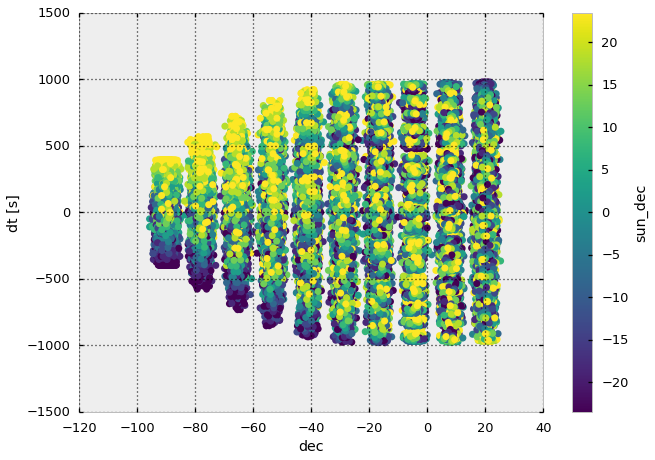

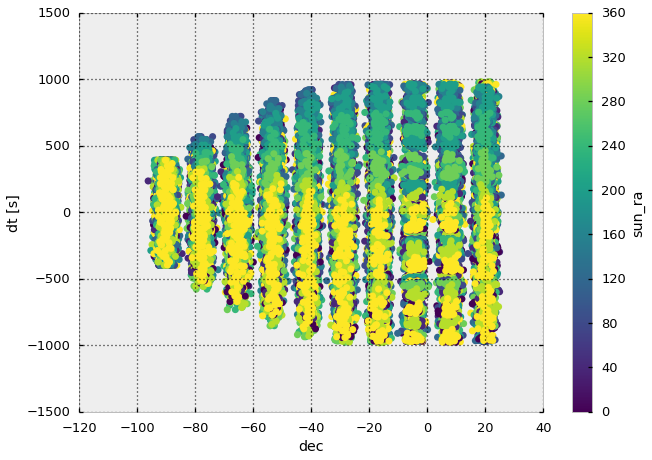

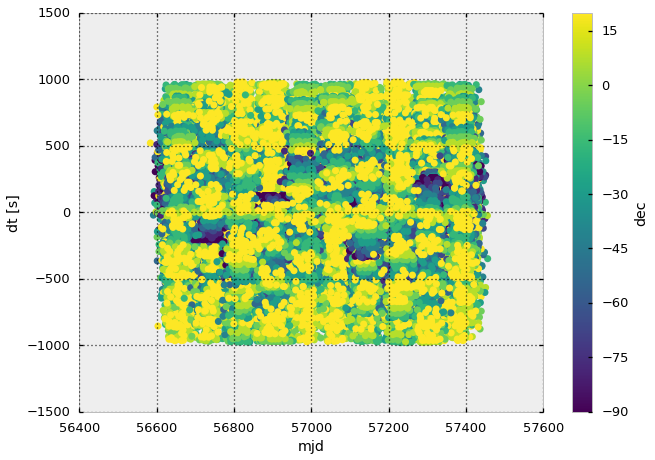

...

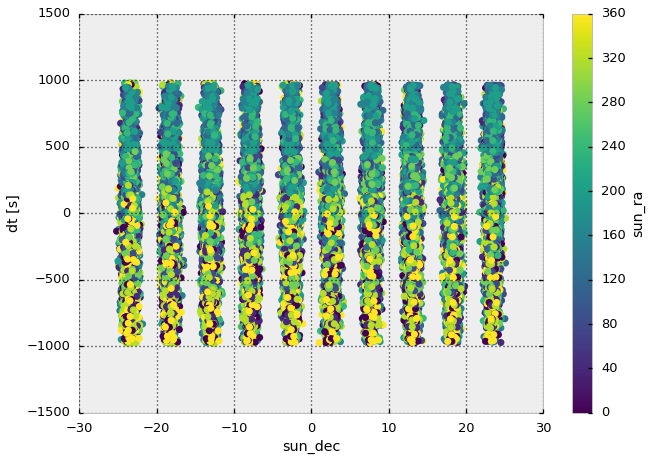

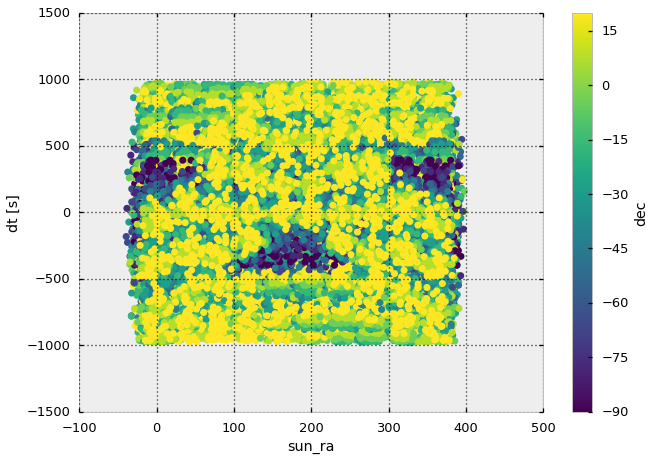

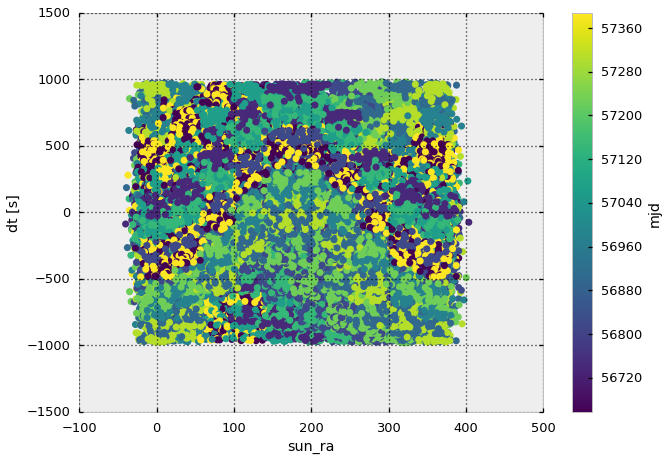

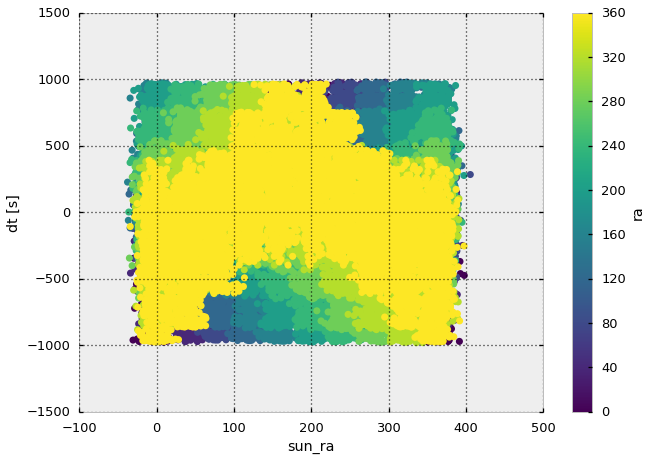

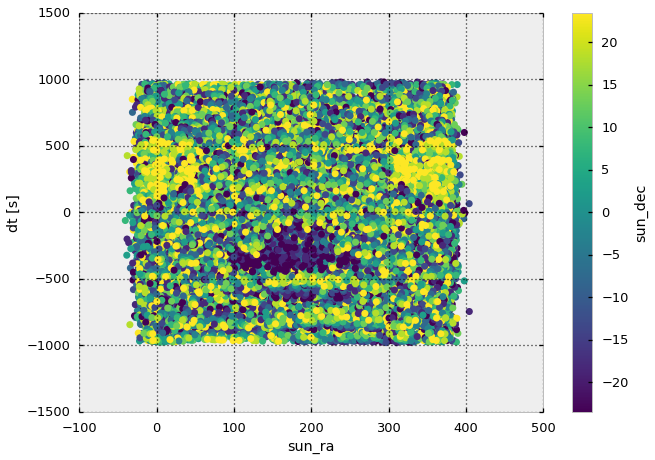

In [20]:
compare_3d(results, add_xnoise=True)